In [1]:
import numpy as np
import matplotlib.pyplot as plt
import datetime
import copy
import time

import sys
sys.path.append('../../')

from data.processing import get_data

import models

from main.seir.fitting import single_fitting_cycle
from main.seir.forecast import get_forecast, forecast_all_trials, create_all_trials_csv, create_decile_csv_new, predict_r0_multipliers, save_r0_mul
from main.seir.sensitivity import calculate_sensitivity_and_plot
from utils.generic.create_report import save_dict_and_create_report
from utils.generic.config import read_config
from utils.generic.enums import Columns
from utils.fitting.loss import Loss_Calculator
#from utils.generic.logging import log_wandb
from viz import plot_forecast, plot_top_k_trials, plot_ptiles, plot_r0_multipliers

import yaml

In [2]:
place_list = [('Jharkhand', None), ('Jharkhand', 'Bokaro'), ('Jharkhand', 'Dhanbad'), ('Jharkhand', 'East Singhbhum')]
pop_list = [3.772e+7, 2.36e+6, 3.07e+6, 2.62e+6]

In [3]:
config_list = ['jharkhand.yaml', 'dhanbad.yaml', 'bokaro.yaml', 'east singhbhum.yaml', 'ranchi.yaml']

In [4]:
config_filename = 'dhanbad.yaml'
config = read_config(config_filename)

  Jharkhand     110      88         19         3    10987.0   
..         ...        ...     ...     ...        ...       ...        ...   
193 2020-11-05  Jharkhand  103543    4685      97964       894  3540776.0   
194 2020-11-06  Jharkhand  103899    4639      98365       895  3576191.0   
195 2020-11-07  Jharkhand  104239    4566      98776       897  3607753.0   
196 2020-11-08  Jharkhand  104442    4471      99074       897  3632362.0   
197 2020-11-09  Jharkhand  104688    4251      99532       905  3656926.0   

     migrated  other  daily_cases  
0         NaN    NaN          NaN  
1         NaN    NaN         21.0  
2         NaN    NaN          2.0  
3         NaN    NaN          2.0  
4         NaN    NaN          3.0  
..        ...    ...          ...  
193       NaN    NaN        355.0  
194       NaN    NaN        356.0  
195       NaN    NaN        340.0  
196       NaN    NaN        203.0  
197       NaN    NaN        246.0  

[198 rows x 10 columns]
          date   

[127 rows x 10 columns]
splitting data ..
TVT:  12 3 7
CODECODECODECODECODECODECODE
          date      state district  total  active  recovered  deceased  \
0   2020-07-06  Jharkhand  Dhanbad    190      67        122         1   
1   2020-07-07  Jharkhand  Dhanbad    219      94        122         3   
2   2020-07-08  Jharkhand  Dhanbad    248     121        124         3   
3   2020-07-09  Jharkhand  Dhanbad    265     126        136         3   
4   2020-07-10  Jharkhand  Dhanbad    273     129        141         3   
..         ...        ...      ...    ...     ...        ...       ...   
122 2020-11-05  Jharkhand  Dhanbad   6519     255       6182        82   
123 2020-11-06  Jharkhand  Dhanbad   6544     249       6212        83   
124 2020-11-07  Jharkhand  Dhanbad   6588     267       6238        83   
125 2020-11-08  Jharkhand  Dhanbad   6603     246       6274        83   
126 2020-11-09  Jharkhand  Dhanbad   6627     247       6296        84   

     tested  other  daily_c

e      state district  total  active  recovered  deceased  \
0   2020-04-26  Jharkhand   Bokaro     10       5          4         1   
1   2020-04-27  Jharkhand   Bokaro     10       5          4         1   
2   2020-04-28  Jharkhand   Bokaro     10       5          4         1   
3   2020-04-29  Jharkhand   Bokaro     10       5          4         1   
4   2020-04-30  Jharkhand   Bokaro     10       5          4         1   
..         ...        ...      ...    ...     ...        ...       ...   
193 2020-11-05  Jharkhand   Bokaro   5548     243       5259        46   
194 2020-11-06  Jharkhand   Bokaro   5571     237       5288        46   
195 2020-11-07  Jharkhand   Bokaro   5602     186       5370        46   
196 2020-11-08  Jharkhand   Bokaro   5622     176       5400        46   
197 2020-11-09  Jharkhand   Bokaro   5641     155       5439        47   

      tested  other  daily_cases  
0        NaN    NaN          NaN  
1        NaN    NaN          0.0  
2        NaN    NaN

East Singhbhum  16476    1305      14834       337   
125 2020-11-06  Jharkhand  East Singhbhum  16514    1297      14880       337   
126 2020-11-07  Jharkhand  East Singhbhum  16558    1299      14922       337   
127 2020-11-08  Jharkhand  East Singhbhum  16571    1274      14960       337   
128 2020-11-09  Jharkhand  East Singhbhum  16619    1280      14999       340   

     tested  other  daily_cases  
0       NaN    NaN          NaN  
1       NaN    NaN         25.0  
2       NaN    NaN         12.0  
3       NaN    NaN         56.0  
4       NaN    NaN         19.0  
..      ...    ...          ...  
124     NaN    NaN         26.0  
125     NaN    NaN         38.0  
126     NaN    NaN         44.0  
127     NaN    NaN         13.0  
128     NaN    NaN         48.0  

[129 rows x 10 columns]
          date      state        district  total  active  recovered  deceased  \
0   2020-07-04  Jharkhand  East Singhbhum    480     233        246         1   
1   2020-07-05  Jharkhand 

s x 10 columns]
splitting data ..
TVT:  12 3 7
CODECODECODECODECODECODECODE
          date      state district  total  active  recovered  deceased  \
0   2020-04-26  Jharkhand   Ranchi     55      47          6         2   
1   2020-04-27  Jharkhand   Ranchi     75      63         10         2   
2   2020-04-28  Jharkhand   Ranchi     77      65         10         2   
3   2020-04-29  Jharkhand   Ranchi     78      66         10         2   
4   2020-04-30  Jharkhand   Ranchi     81      69         10         2   
..         ...        ...      ...    ...     ...        ...       ...   
193 2020-11-05  Jharkhand   Ranchi  26190    1532      24480       178   
194 2020-11-06  Jharkhand   Ranchi  26281    1492      24611       178   
195 2020-11-07  Jharkhand   Ranchi  26367    1440      24748       179   
196 2020-11-08  Jharkhand   Ranchi  26427    1412      24836       179   
197 2020-11-09  Jharkhand   Ranchi  26479    1292      25007       180   

     tested  other  daily_cases  
0


getting forecasts ..
getting forecasts ..
12it [00:00, 119.53it/s]getting forecasts ..
1000it [00:09, 104.54it/s]
13it [00:00, 117.98it/s]getting forecasts ..
1000it [00:12, 78.88it/s]
100%|██████████| 100/100 [00:48<00:00,  2.04trial/s, best loss: 3.9197894827773188]
getting forecasts ..
getting forecasts ..
getting forecasts ..
getting forecasts ..
getting forecasts ..
getting forecasts ..
DONE WITH ONCALL 5


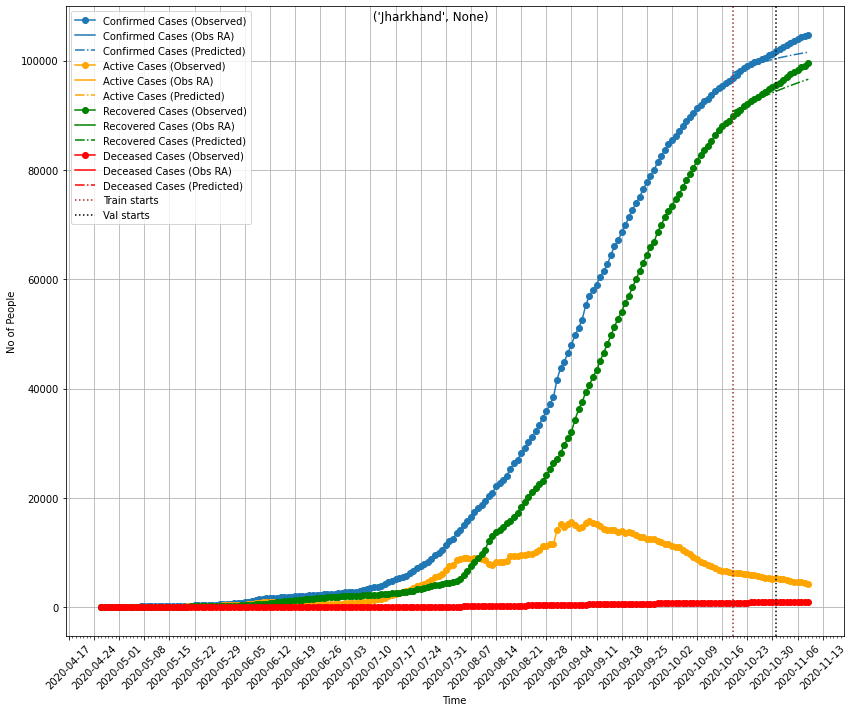

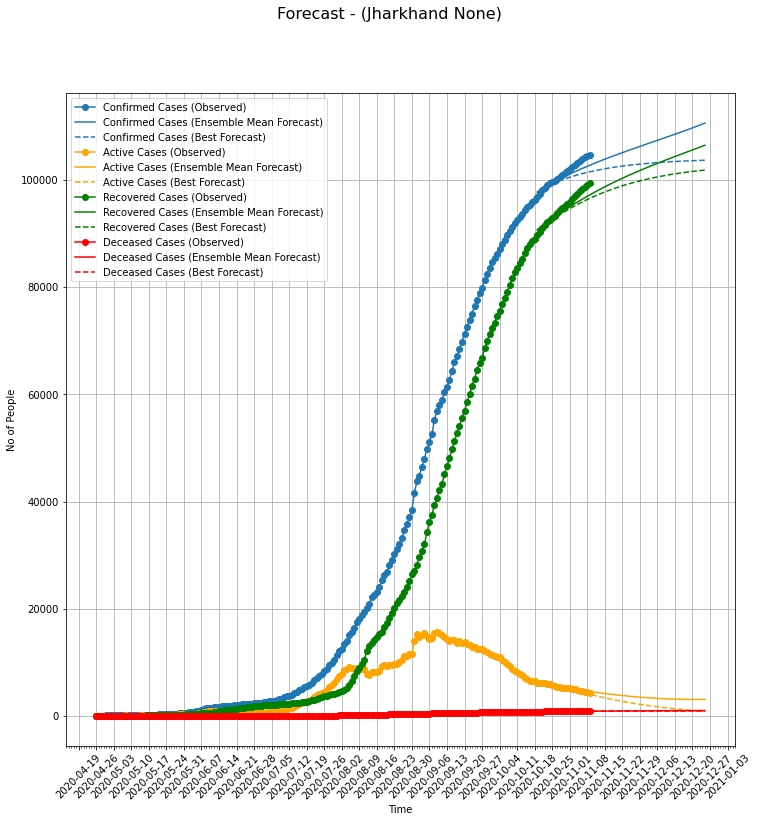

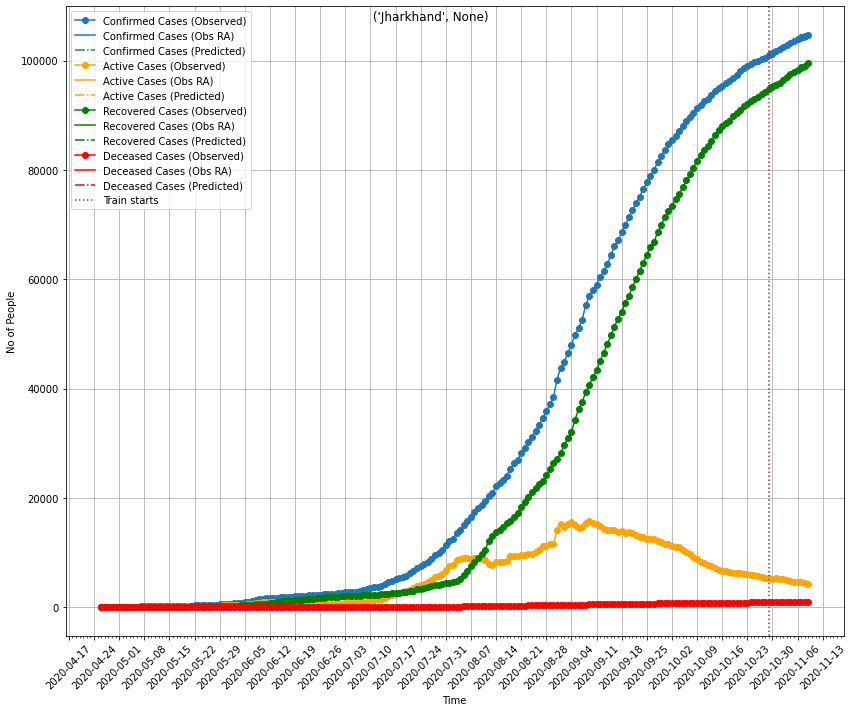

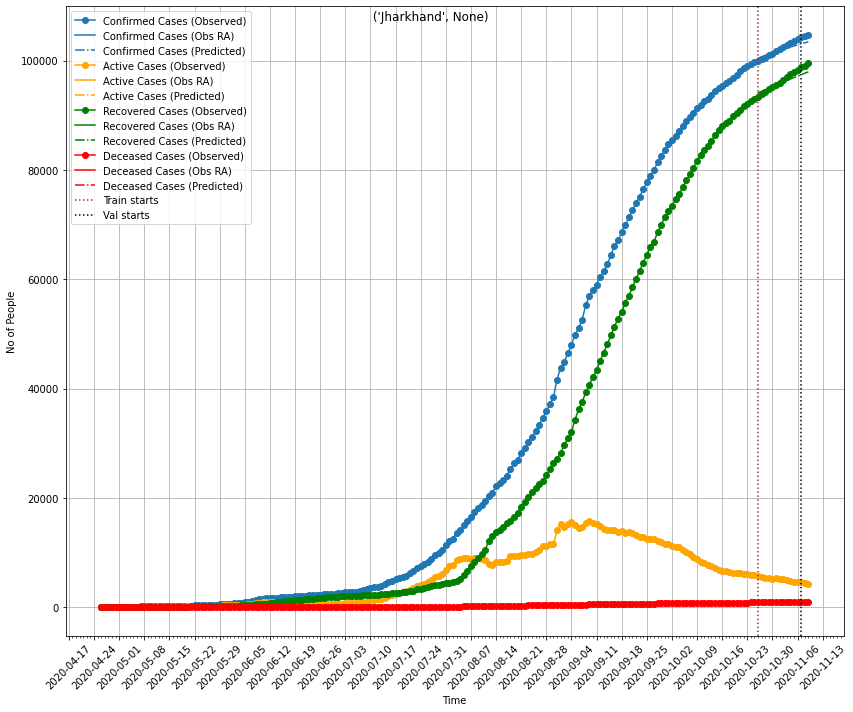

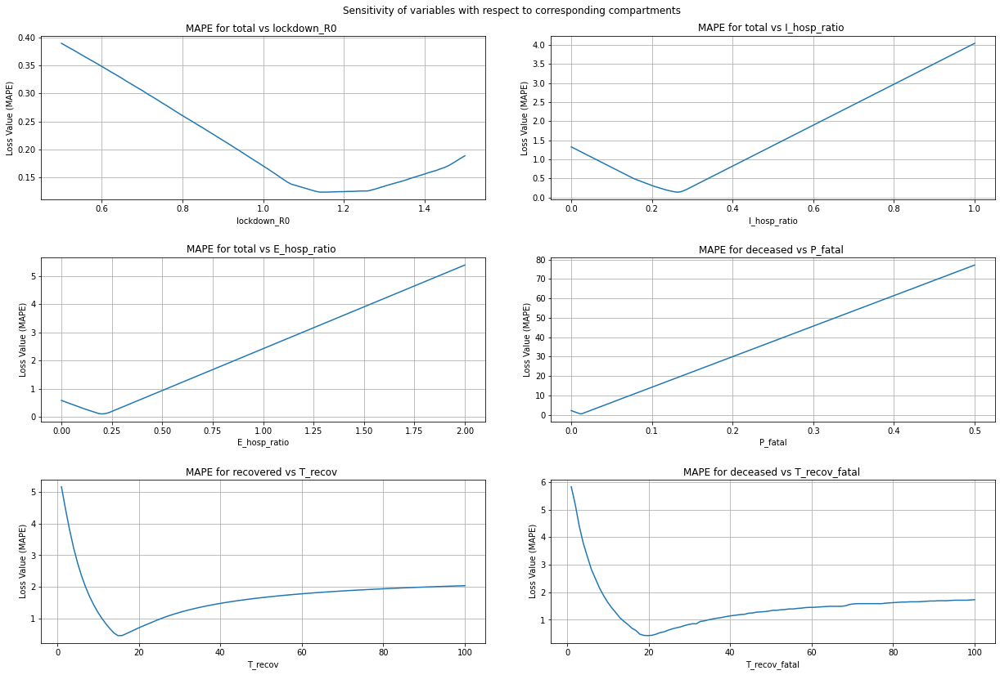

...

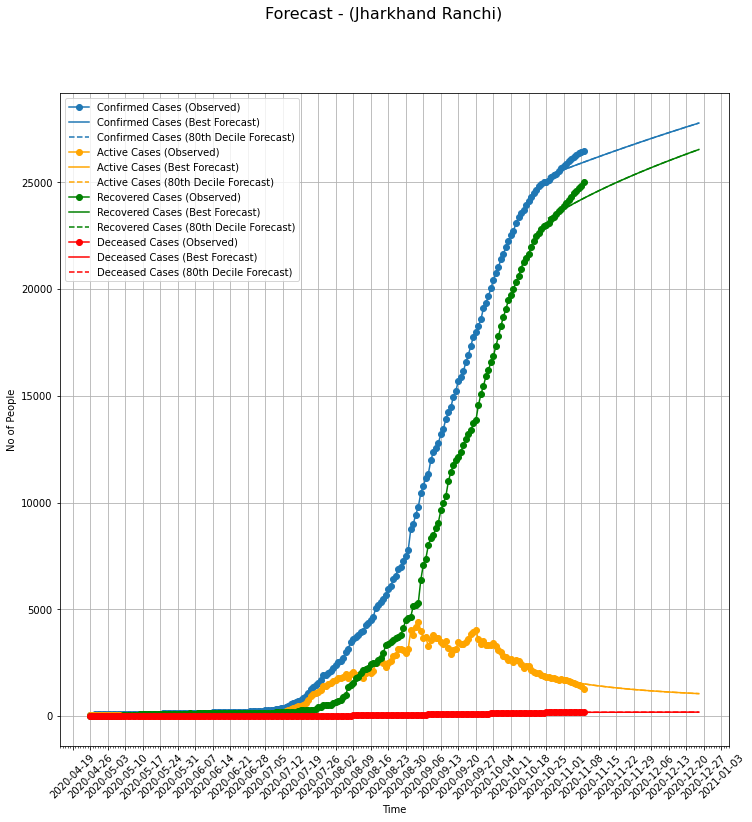

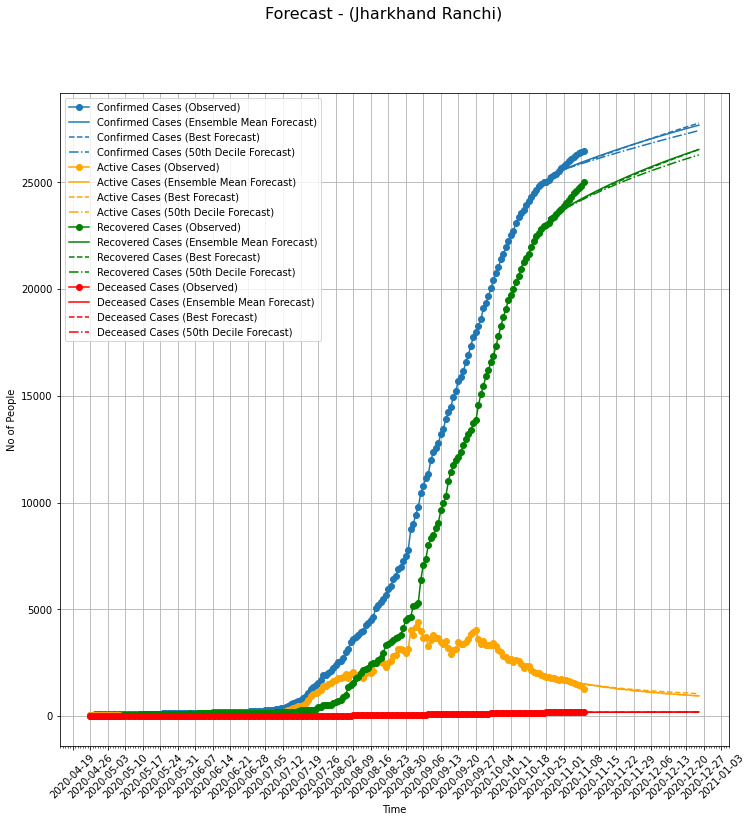

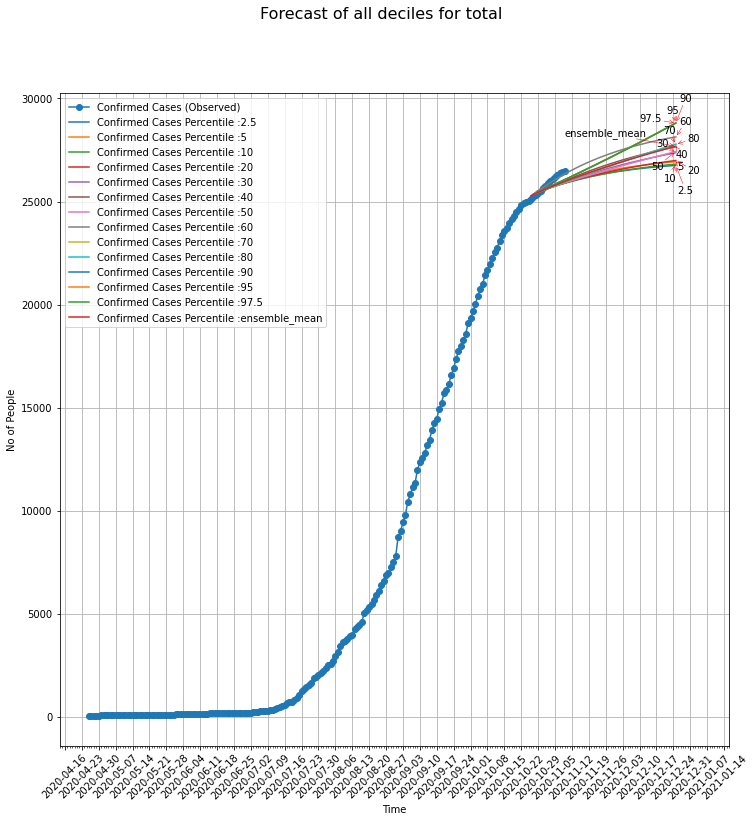

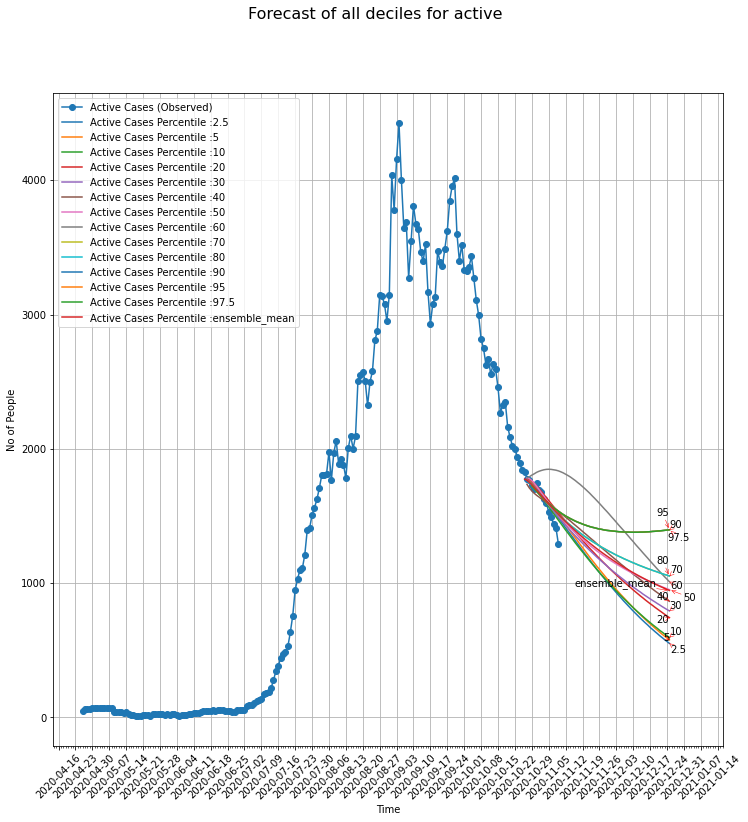

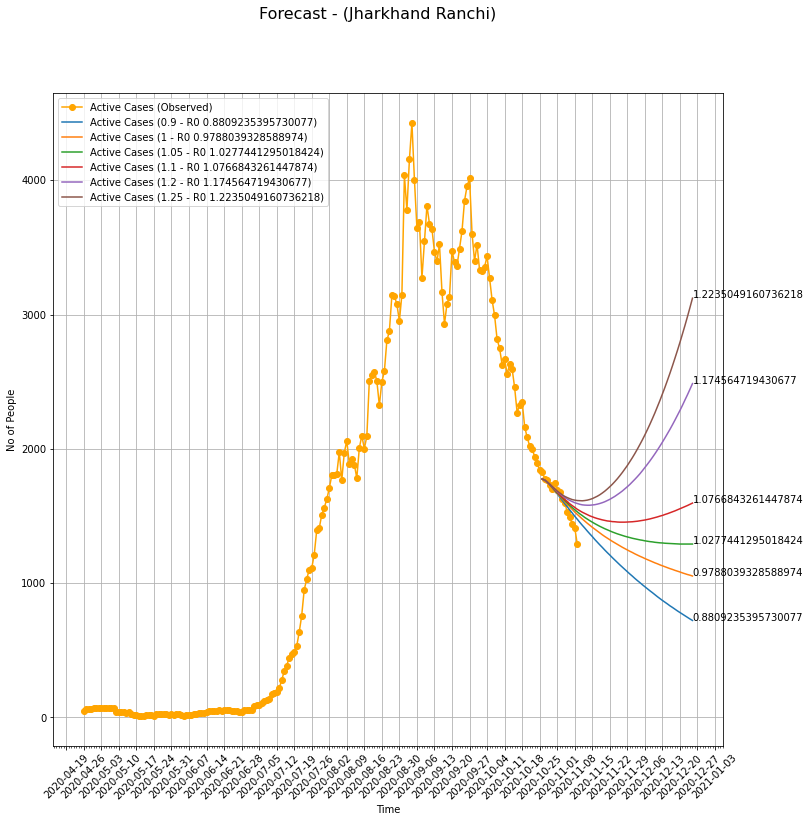

In [5]:
for i, config_filename in enumerate(config_list):

    config = read_config(config_filename)

    '''
    # READING THE DEFAULT CONFIG FILE
    config_filename = 'dhanbad.yaml'
    config = read_config(config_filename)
    
    # UPDATING THE TARGET LOCATION
    state, district = place
    config['fitting']['data']['dataloading_params']['state'] = state
    config['fitting']['data']['dataloading_params']['district'] = district
    config['fitting']['default_params']['N'] = pop_list[i]
    '''

    state = config['fitting']['data']['dataloading_params']['state'] 
    district = config['fitting']['data']['dataloading_params']['district']

    print("RUNNING ONCALL {} FOR {} - {}".format(i + 1, state, district))

    predictions_dict = {}

    state = config['fitting']['data']['dataloading_params']['state'] 
    district = config['fitting']['data']['dataloading_params']['district']

    output_folder = '../../misc/reports/{}_{}-{}'.format(datetime.datetime.now().strftime("%Y_%m%d_%H%M%S"), state, district)

    train_period, val_period, test_period = config['fitting']['split']['train_period'], config['fitting']['split']['val_period'], config['fitting']['split']['test_period']

    m0_params = copy.deepcopy(config['fitting'])
    m1_params = copy.deepcopy(config['fitting'])
    m2_params = copy.deepcopy(config['fitting'])

    m1_params['split']['val_period'] = 0
    m1_params['split']['test_period'] = 0

    m2_params['split']['test_period'] = 0

    predictions_dict['fitting_date'] = datetime.datetime.now().strftime("%Y-%m-%d")

    predictions_dict['m0'] = single_fitting_cycle(**m0_params)

    config_0 = copy.deepcopy(config)
    config_0['uncertainty']['uncertainty_params']['which_fit']='m0'

    predictions_dict['m0']['trials_processed'] = forecast_all_trials(predictions_dict, train_fit='m0', 
                                                                 model=config_0['fitting']['model'], 
                                                                 forecast_days=config['forecast']['forecast_days'])

    uncertainty_args = {'predictions_dict': predictions_dict, **config_0['uncertainty']['uncertainty_params']}
    uncertainty = config_0['uncertainty']['method'](**uncertainty_args)

    predictions_dict['m0']['forecasts'] = {}

    uncertainty_forecasts = uncertainty.get_forecasts()
    for key in uncertainty_forecasts.keys():
        predictions_dict['m0']['forecasts'][key] = uncertainty_forecasts[key]['df_prediction']
        
    predictions_dict['m0']['forecasts']['ensemble_mean'] = uncertainty.ensemble_mean_forecast

    predictions_dict['m0']['forecasts']['best'] = get_forecast(predictions_dict, train_fit='m0', 
                                                               model=config['fitting']['model'], 
                                                               days=config['forecast']['forecast_days'])

    predictions_dict['m0']['plots']['forecast_ensemble_mean_best'] = plot_forecast(predictions_dict,
                (config['fitting']['data']['dataloading_params']['state'], config['fitting']['data']['dataloading_params']['district']), which_fit='m0', fits_to_plot =['ensemble_mean', 'best'],
                error_bars=True) 
    

    
    predictions_dict['m1'] = single_fitting_cycle(**m1_params) 
    predictions_dict['m2'] = single_fitting_cycle(**m2_params)



    predictions_dict['m0']['plots']['sensitivity'], _, _ = calculate_sensitivity_and_plot(predictions_dict, config, which_fit='m0')
    predictions_dict['m1']['plots']['sensitivity'], _, _ = calculate_sensitivity_and_plot(predictions_dict, config, which_fit='m1')
    predictions_dict['m2']['plots']['sensitivity'], _, _ = calculate_sensitivity_and_plot(predictions_dict, config, which_fit='m2')

    

    '''
    # M2 based forecasting for the next train_period + test_period + forecast_period (no validation period)
    predictions_dict['m0']['forecasts'] = {}
    predictions_dict['m0']['forecasts']['best'] = get_forecast(predictions_dict, train_fit='m0', 
                                                               model=config['fitting']['model'], 
                                                               days=config['forecast']['forecast_days'])

    '''

    # M2 based forecasting for the next train_period + test_period + forecast_period (no validation period)
    predictions_dict['m1']['forecasts'] = {}
    predictions_dict['m1']['forecasts']['best'] = get_forecast(predictions_dict, train_fit='m1', 
                                                               model=config['fitting']['model'], 
                                                               days=config['forecast']['forecast_days'])



    # M2 based forecasting for the next train_period + test_period + forecast_period (no validation period)
    predictions_dict['m2']['forecasts'] = {}
    predictions_dict['m2']['forecasts']['best'] = get_forecast(predictions_dict, train_fit='m2', 
                                                               model=config['fitting']['model'], 
                                                               days=config['forecast']['forecast_days'])
                                                             


    # Predictions plotted are for the most recent train_period days + test_period + forecast_period (no validation_period)
    predictions_dict['m1']['plots']['forecast_best'] = plot_forecast(predictions_dict,
                (config['fitting']['data']['dataloading_params']['state'], config['fitting']['data']['dataloading_params']['district']), which_fit='m1',
                error_bars=True)

    # Predictions plotted are for the most recent train_period days + test_period + forecast_period (no validation_period)
    predictions_dict['m2']['plots']['forecast_best'] = plot_forecast(predictions_dict,
                (config['fitting']['data']['dataloading_params']['state'], config['fitting']['data']['dataloading_params']['district']), which_fit = 'm2',
                error_bars=True)


    predictions_dict['m1']['trials_processed'] = forecast_all_trials(predictions_dict, train_fit='m1', 
                                                                 model=config['fitting']['model'], 
                                                                 forecast_days=config['forecast']['forecast_days'])


    predictions_dict['m2']['trials_processed'] = forecast_all_trials(predictions_dict, train_fit='m2', 
                                                                 model=config['fitting']['model'], 
                                                                 forecast_days=config['forecast']['forecast_days'])

    kforecasts = plot_top_k_trials(predictions_dict, train_fit='m1',
                               k=config['forecast']['num_trials_to_plot'],
                               which_compartments=config['forecast']['plot_topk_trials_for_columns'])


    predictions_dict['m1']['plots']['forecasts_topk'] = {}
    for column in config['forecast']['plot_topk_trials_for_columns']:
        predictions_dict['m1']['plots']['forecasts_topk'][column.name] = kforecasts[column]


    uncertainty_args = {'predictions_dict': predictions_dict, **config['uncertainty']['uncertainty_params']}
    uncertainty = config['uncertainty']['method'](**uncertainty_args)

    uncertainty_forecasts = uncertainty.get_forecasts()
    for key in uncertainty_forecasts.keys():
        predictions_dict['m2']['forecasts'][key] = uncertainty_forecasts[key]['df_prediction']
    
    predictions_dict['m2']['forecasts']['ensemble_mean'] = uncertainty.ensemble_mean_forecast

    predictions_dict['m2']['beta'] = uncertainty.beta
    predictions_dict['m2']['beta_loss'] = uncertainty.beta_loss
    predictions_dict['m2']['deciles'] = uncertainty_forecasts
    
    predictions_dict['m2']['plots']['forecast_best_50'] = plot_forecast(predictions_dict, 
                                                                        (config['fitting']['data']['dataloading_params']['state'], 
                                                                         config['fitting']['data']['dataloading_params']['district']),
                                                                         fits_to_plot=['best', 50], error_bars=False)
    predictions_dict['m2']['plots']['forecast_best_80'] = plot_forecast(predictions_dict, 
                                                                        (config['fitting']['data']['dataloading_params']['state'], 
                                                                         config['fitting']['data']['dataloading_params']['district']),
                                                                         fits_to_plot=['best', 80], error_bars=False)
    predictions_dict['m2']['plots']['forecast_ensemble_mean_50'] = plot_forecast(predictions_dict, 
                                                                                 (config['fitting']['data']['dataloading_params']['state'], 
                                                                                  config['fitting']['data']['dataloading_params']['district']),
                                                                                  fits_to_plot=['ensemble_mean', 'best', 50], error_bars=False)

    ptiles_plots = plot_ptiles(predictions_dict, which_compartments=config['forecast']['plot_ptiles_for_columns'])
    predictions_dict['m2']['plots']['forecasts_ptiles'] = {}
    for column in config['forecast']['plot_ptiles_for_columns']:
        predictions_dict['m2']['plots']['forecasts_ptiles'][column.name] = ptiles_plots[column]
    
    
    r0_mul_params= predictions_dict['m2']['deciles'][config['what_ifs']['percentile']]['params']
    
    predictions_dict['m2']['r0_mul_dict'] = predict_r0_multipliers(predictions_dict, r0_mul_params, model=config['fitting']['model'], days=config['forecast']['forecast_days'], multipliers=config['what_ifs']['multipliers'])
    
    predictions_dict['m2']['plots']['r0_mul_dict'] = plot_r0_multipliers(predictions_dict, None, predictions_dict['m2']['r0_mul_dict'], None, config['fitting']['data']['dataloading_params']['state'], config['fitting']['data']['dataloading_params']['district'])

    save_dict_and_create_report(predictions_dict, config, ROOT_DIR=output_folder, config_filename=config_filename)

    df_output = create_decile_csv_new(predictions_dict)
    df_output.to_csv(f'{output_folder}/deciles.csv')

    df_all = create_all_trials_csv(predictions_dict)
    df_all.to_csv(f'{output_folder}/all_trials.csv')

    save_r0_mul(predictions_dict['m2']['r0_mul_dict'], output_folder)

    predictions_dict['m1']['df_district'].to_csv(f'{output_folder}/df_district.csv')

    print('DONE WITH ONCALL {}'.format(i + 1)) 